In [58]:

# import 'Pandas' 
import pandas as pd 

# import 'Numpy' 
import numpy as np

# import subpackage of Matplotlib
import matplotlib.pyplot as plt

# import 'Seaborn' 
import seaborn as sns

# to suppress warnings 
from warnings import filterwarnings
filterwarnings('ignore')

# import train-test split 
from sklearn.model_selection import train_test_split

# import function to perform linear regression using OLS
import statsmodels.api as sm

# 'metrics' from sklearn is used for evaluating the model performance
from sklearn.metrics import mean_squared_error

# import function to perform linear regression
from sklearn.linear_model import LinearRegression

# import StandardScaler to perform scaling
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from scipy.stats import boxcox

# import SGDRegressor from sklearn to perform linear regression with stochastic gradient descent
from sklearn.linear_model import SGDRegressor
from sklearn.ensemble import RandomForestRegressor,AdaBoostRegressor,GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV,cross_val_score,KFold


# import function for lasso regression
from sklearn.linear_model import Lasso

# import function for elastic net regression
from sklearn.linear_model import ElasticNet

# import function to perform GridSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn import model_selection

#importing several other functions
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import RepeatedKFold, train_test_split
from sklearn.metrics import mean_squared_error


from sklearn.linear_model import BayesianRidge, Lasso, LinearRegression, Ridge, RidgeCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR

## Data Understanding

In [59]:
df=pd.read_csv('train.csv')

In [60]:
df.head()

,POSTED_BY,UNDER_CONSTRUCTION,RERA,BHK_NO.,BHK_OR_RK,SQUARE_FT,READY_TO_MOVE,RESALE,ADDRESS,LONGITUDE,LATITUDE,TARGET(PRICE_IN_LACS)
0,Owner,0,0,2,BHK,1300.236407,1,1,"Ksfc Layout,Bangalore",12.969910,77.597960,55.0
1,Dealer,0,0,2,BHK,1275.000000,1,1,"Vishweshwara Nagar,Mysore",12.274538,76.644605,51.0
2,Owner,0,0,2,BHK,933.159722,1,1,"Jigani,Bangalore",12.778033,77.632191,43.0
3,Owner,0,1,2,BHK,929.921143,1,1,"Sector-1 Vaishali,Ghaziabad",28.642300,77.344500,62.5
4,Dealer,1,0,2,BHK,999.009247,0,1,"New Town,Kolkata",22.592200,88.484911,60.5


In [61]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29451 entries, 0 to 29450
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   POSTED_BY              29451 non-null  object 
 1   UNDER_CONSTRUCTION     29451 non-null  int64  
 2   RERA                   29451 non-null  int64  
 3   BHK_NO.                29451 non-null  int64  
 4   BHK_OR_RK              29451 non-null  object 
 5   SQUARE_FT              29451 non-null  float64
 6   READY_TO_MOVE          29451 non-null  int64  
 7   RESALE                 29451 non-null  int64  
 8   ADDRESS                29451 non-null  object 
 9   LONGITUDE              29451 non-null  float64
 10  LATITUDE               29451 non-null  float64
 11  TARGET(PRICE_IN_LACS)  29451 non-null  float64
dtypes: float64(4), int64(5), object(3)
memory usage: 2.7+ MB


In [62]:
df.describe()

,UNDER_CONSTRUCTION,RERA,BHK_NO.,SQUARE_FT,READY_TO_MOVE,RESALE,LONGITUDE,LATITUDE,TARGET(PRICE_IN_LACS)
count,29451.000000,29451.000000,29451.000000,2.945100e+04,29451.000000,29451.000000,29451.000000,29451.000000,29451.000000
mean,0.179756,0.317918,2.392279,1.980217e+04,0.820244,0.929578,21.300255,76.837695,142.898746
std,0.383991,0.465675,0.879091,1.901335e+06,0.383991,0.255861,6.205306,10.557747,656.880713
min,0.000000,0.000000,1.000000,3.000000e+00,0.000000,0.000000,-37.713008,-121.761248,0.250000
25%,0.000000,0.000000,2.000000,9.000211e+02,1.000000,1.000000,18.452663,73.798100,38.000000
50%,0.000000,0.000000,2.000000,1.175057e+03,1.000000,1.000000,20.750000,77.324137,62.000000
75%,0.000000,1.000000,3.000000,1.550688e+03,1.000000,1.000000,26.900926,77.828740,100.000000
max,1.000000,1.000000,20.000000,2.545455e+08,1.000000,1.000000,59.912884,152.962676,30000.000000


## Data Cleaning

<AxesSubplot:xlabel='TARGET(PRICE_IN_LACS)'>

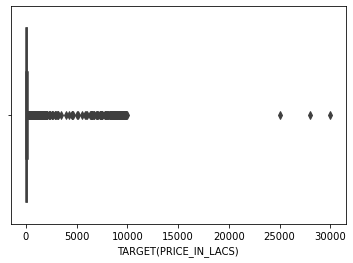

In [63]:
sns.boxplot(df['TARGET(PRICE_IN_LACS)'])

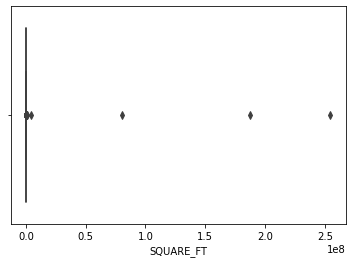

In [64]:
sns.boxplot(df['SQUARE_FT'])
plt.show()

In [65]:
df['SQUARE_FT'].sort_values(ascending=False).head(10)

10745    2.545455e+08
11238    1.875000e+08
15724    8.064516e+07
25241    4.300000e+06
28591    8.750000e+05
15598    7.928571e+05
373      4.333333e+05
22155    3.400000e+05
19047    2.460088e+05
13035    2.425000e+05
Name: SQUARE_FT, dtype: float64

<AxesSubplot:xlabel='BHK_NO.'>

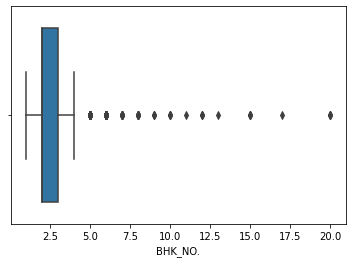

In [66]:
sns.boxplot(df['BHK_NO.'])

##### Unusual outliers are found in the Number of Bedrooms, Area and in the Price column of the dataset, removing them can help us building a better model for house price prediction

In [67]:
df = df[(df['TARGET(PRICE_IN_LACS)']<15000) & 
        (df['SQUARE_FT']<400000) & (df['BHK_NO.']<=5)]

print('Shape of the dataset after neglecting the outliers {}'.format(df.shape))

Shape of the dataset after neglecting the outliers (29350, 12)


In [68]:
df.ADDRESS.value_counts()

Zirakpur,Chandigarh              509
Whitefield,Bangalore             230
Raj Nagar Extension,Ghaziabad    215
Sector-137 Noida,Noida           139
New Town,Kolkata                 131
                                ... 
Unit 4,Bhubaneswar                 1
R.G.Baruah Road,Guwahati           1
Pali Hill,Maharashtra              1
Khurda,Bhubaneswar                 1
Edakochi,Ernakulam                 1
Name: ADDRESS, Length: 6858, dtype: int64

In [69]:
df['ADDRESS'] = df['ADDRESS'].str.split(',').apply(lambda x: x[-1])

In [70]:
df.ADDRESS.unique()

array(['Bangalore', 'Mysore', 'Ghaziabad', 'Kolkata', 'Kochi', 'Jaipur',
       'Mohali', 'Chennai', 'Siliguri', 'Noida', 'Raigad', 'Bhubaneswar',
       'Wardha', 'Pune', 'Mumbai', 'Nagpur', 'Deoghar', 'Bhiwadi',
       'Faridabad', 'Lalitpur', 'Maharashtra', 'Vadodara',
       'Visakhapatnam', 'Vapi', 'Mangalore', 'Aurangabad', 'Ottapalam',
       'Vijayawada', 'Belgaum', 'Bhopal', 'Lucknow', 'Kanpur',
       'Gandhinagar', 'Pondicherry', 'Agra', 'Ranchi', 'Gurgaon', 'Udupi',
       'Indore', 'Jodhpur', 'Coimbatore', 'Valsad', 'Palghar', 'Surat',
       'Varanasi', 'Guwahati', 'Amravati', 'Anand', 'Tirupati',
       'Secunderabad', 'Raipur', 'Vizianagaram', 'Thrissur', 'Satna',
       'Madurai', 'Chandigarh', 'Shimla', 'Gwalior', 'Rajkot', 'Sonipat',
       'Allahabad', 'Berhampur', 'Roorkee', 'Dharuhera', 'Latur',
       'Durgapur', 'Panchkula', 'Solapur', 'Durg', 'Goa', 'Jamshedpur',
       'Hazaribagh', 'Jabalpur', 'Hosur', 'Morbi', 'Hubli', 'Karnal',
       'Patna', 'Bilaspur', '

### Adding a column for better analysis

In [71]:
tier1 = ["Ahmedabad", "Bangalore", "Chennai", "Delhi", "Hyderabad", "Kolkata", "Mumbai", "Pune"]
tier2=['Agra', 'Ajmer', 'Aligarh', 'Amravati', 'Amritsar', 'Asansol', 'Aurangabad', 'Bareilly', 
                  'Belgaum', 'Bhavnagar', 'Bhiwandi', 'Bhopal', 'Bhubaneswar', 'Bikaner', 'Bilaspur', 'Bokaro Steel City', 
                  'Chandigarh', 'Coimbatore', 'Cuttack', 'Dehradun', 'Dhanbad', 'Bhilai', 'Durgapur', 'Dindigul', 'Erode', 
                  'Faridabad', 'Firozabad', 'Ghaziabad', 'Gorakhpur', 'Gulbarga', 'Guntur', 'Gwalior', 'Gurgaon', 'Guwahati', 
                  'Hamirpur', 'Hubli–Dharwad', 'Indore', 'Jabalpur', 'Jaipur', 'Jalandhar', 'Jammu', 'Jamnagar', 'Jamshedpur', 
                  'Jhansi', 'Jodhpur', 'Kakinada', 'Kannur', 'Kanpur', 'Karnal', 'Kochi', 'Kolhapur', 'Kollam', 'Kozhikode', 
                  'Kurnool', 'Ludhiana', 'Lucknow', 'Madurai', 'Malappuram', 'Mathura', 'Mangalore', 'Meerut', 'Moradabad', 
                  'Mysore', 'Nagpur', 'Nanded', 'Nashik', 'Nellore', 'Noida', 'Patna', 'Pondicherry', 'Purulia', 'Prayagraj', 
                  'Raipur', 'Rajkot', 'Rajahmundry', 'Ranchi', 'Rourkela', 'Ratlam', 'Salem', 'Sangli', 'Shimla', 'Siliguri', 
                  'Solapur', 'Srinagar', 'Surat', 'Thanjavur', 'Thiruvananthapuram', 'Thrissur', 'Tiruchirappalli', 'Tirunelveli', 
                  'Tiruvannamalai', 'Ujjain', 'Bijapur', 'Vadodara', 'Varanasi', 'Vasai-Virar City', 'Vijayawada', 'Visakhapatnam', 
                  'Vellore', 'Warangal']

This tier wise data has been obtained from the wikipedia website.

In [72]:
def mapping_city(city):

    if city in tier1:
        return 'tier1'

    elif city in tier2:
        return 'tier2'
        
    else:
        return 'tier3'

df['City_Tier'] = df['ADDRESS'].apply(mapping_city)
df.head()

,POSTED_BY,UNDER_CONSTRUCTION,RERA,BHK_NO.,BHK_OR_RK,SQUARE_FT,READY_TO_MOVE,RESALE,ADDRESS,LONGITUDE,LATITUDE,TARGET(PRICE_IN_LACS),City_Tier
0,Owner,0,0,2,BHK,1300.236407,1,1,Bangalore,12.969910,77.597960,55.0,tier1
1,Dealer,0,0,2,BHK,1275.000000,1,1,Mysore,12.274538,76.644605,51.0,tier2
2,Owner,0,0,2,BHK,933.159722,1,1,Bangalore,12.778033,77.632191,43.0,tier1
3,Owner,0,1,2,BHK,929.921143,1,1,Ghaziabad,28.642300,77.344500,62.5,tier2
4,Dealer,1,0,2,BHK,999.009247,0,1,Kolkata,22.592200,88.484911,60.5,tier1


## EDA

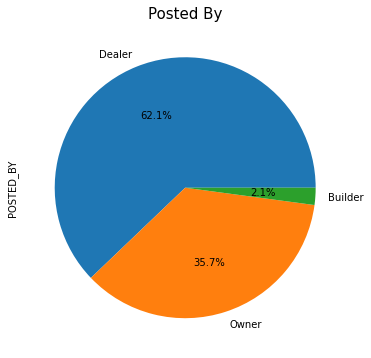

In [75]:
plt.figure(figsize=(6,6))
plt.title('Posted By',size=15)

df['POSTED_BY'].value_counts().plot(kind='pie',autopct='%1.1f%%')
plt.show()

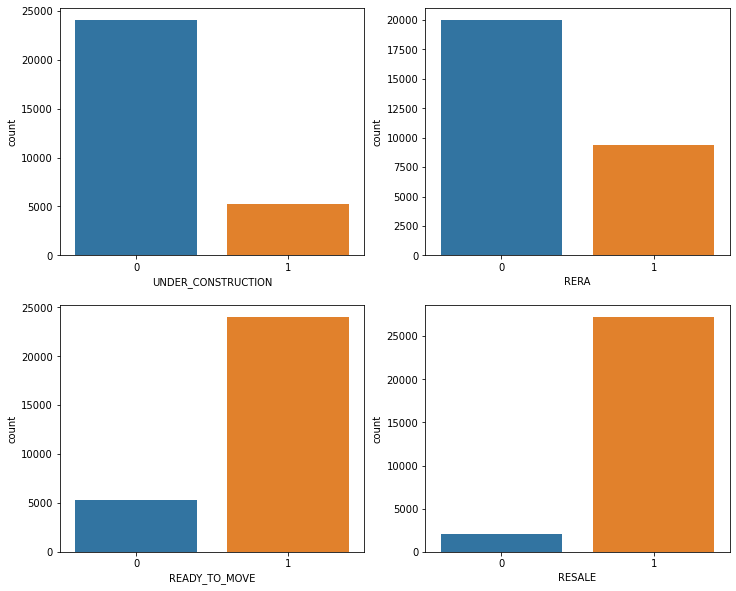

In [17]:
plt.figure(figsize=(12,10))
plt.subplot(2,2,1)
sns.countplot(df['UNDER_CONSTRUCTION'])
plt.subplot(2,2,2)
sns.countplot(df['RERA'])
plt.subplot(2,2,3)
sns.countplot(df['READY_TO_MOVE'])
plt.subplot(2,2,4)
sns.countplot(df['RESALE'])
plt.show()

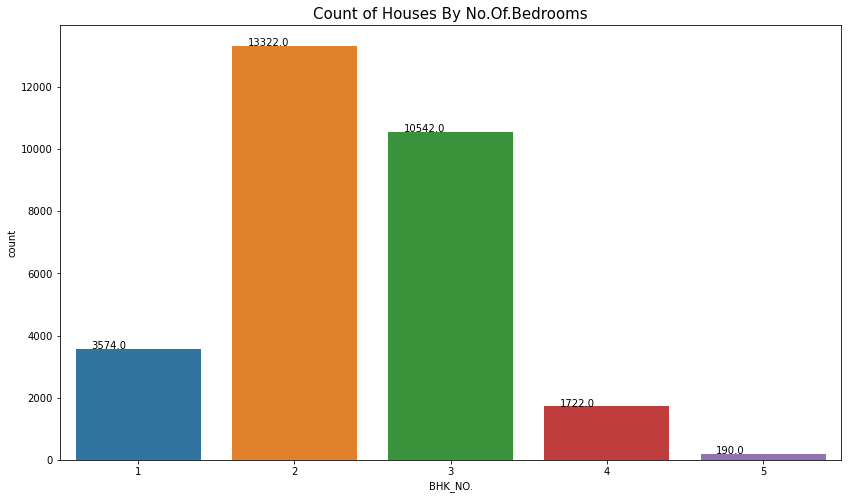

In [74]:
plt.figure(figsize=(14,8))
plt.title('Count of Houses By No.Of.Bedrooms',size=15)

ax = sns.countplot(x="BHK_NO.", data=df)

for p in ax.patches:
    ax.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+0.01))

plt.show()

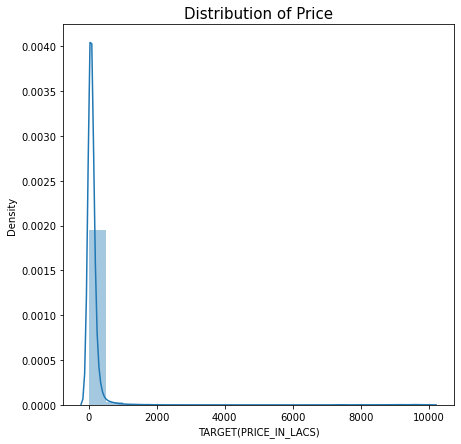

In [77]:
plt.figure(figsize=(7,7))
plt.title('Distribution of Price',size=15)
sns.distplot(df['TARGET(PRICE_IN_LACS)'],bins=20)
plt.show()



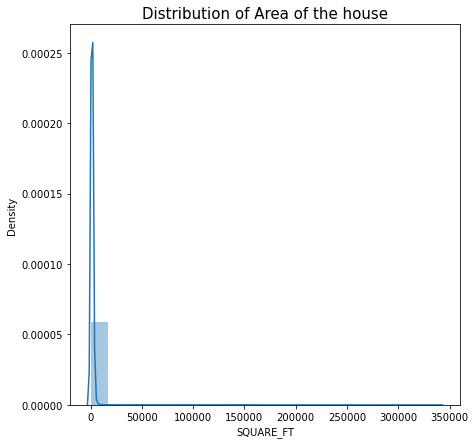

In [78]:
plt.figure(figsize=(7,7))
plt.title('Distribution of Area of the house',size=15)
sns.distplot(df['SQUARE_FT'],bins=20)
plt.show()

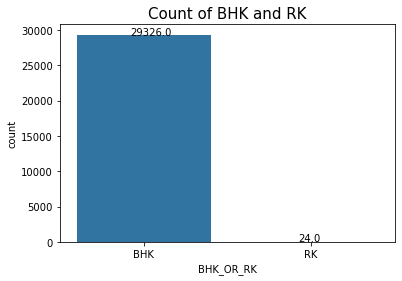

In [79]:
ax = sns.countplot(x="BHK_OR_RK", data=df)
plt.title('Count of BHK and RK',size=15)

for p in ax.patches:
    ax.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.32, p.get_height()+0.02))

plt.show()

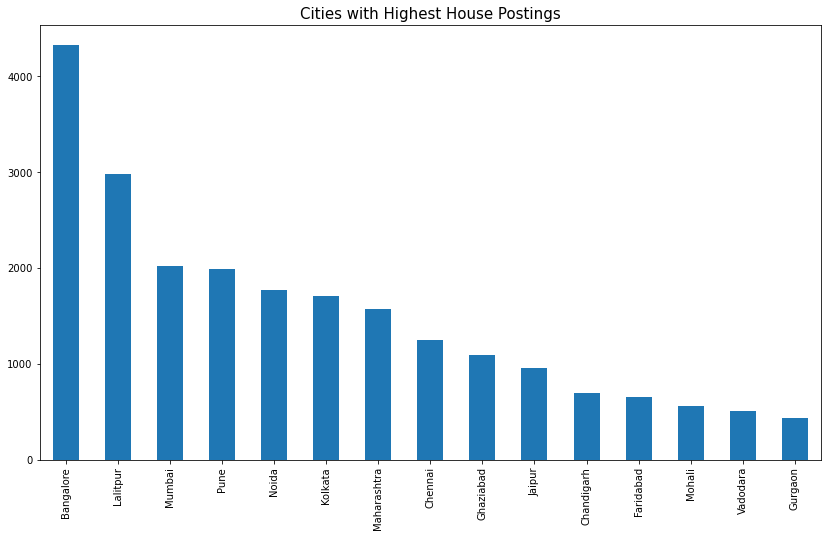

In [80]:
plt.figure(figsize=(14,8))
df['ADDRESS'].value_counts().sort_values(ascending=False).head(15).plot(kind='bar')
plt.title('Cities with Highest House Postings',size=15)
plt.show()

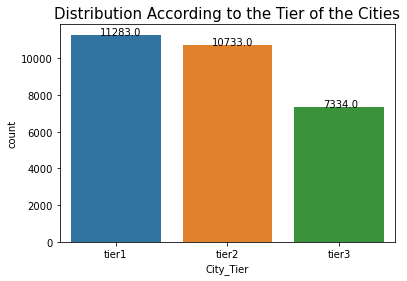

In [81]:
ax = sns.countplot(x="City_Tier", data=df)
plt.title('Distribution According to the Tier of the Cities',size=15)
for p in ax.patches:
    ax.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.26, p.get_height()+0.))

plt.show()

In [83]:
import folium
from folium import Choropleth, Circle, Marker
map = folium.Map(location=[22.00,78.00], tiles='cartodbpositron', zoom_start=4.5)


for i in range(0,len(df)):
    Circle(
        location=[df.iloc[i]['LONGITUDE'], df.iloc[i]['LATITUDE']],
        radius=100,
        color='tomato').add_to(map)

# Display the map
map

### Independent Variables Plotted Against the Target Varible

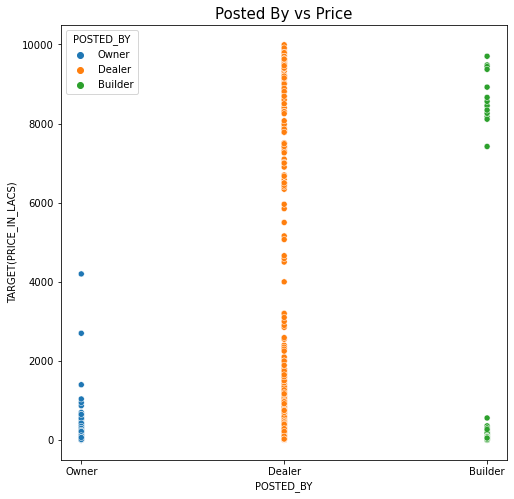

In [84]:
plt.figure(figsize=(8, 8))
plt.title('Posted By vs Price',size=15)
sns.scatterplot('POSTED_BY','TARGET(PRICE_IN_LACS)', data=df,hue='POSTED_BY'
               )
plt.show()


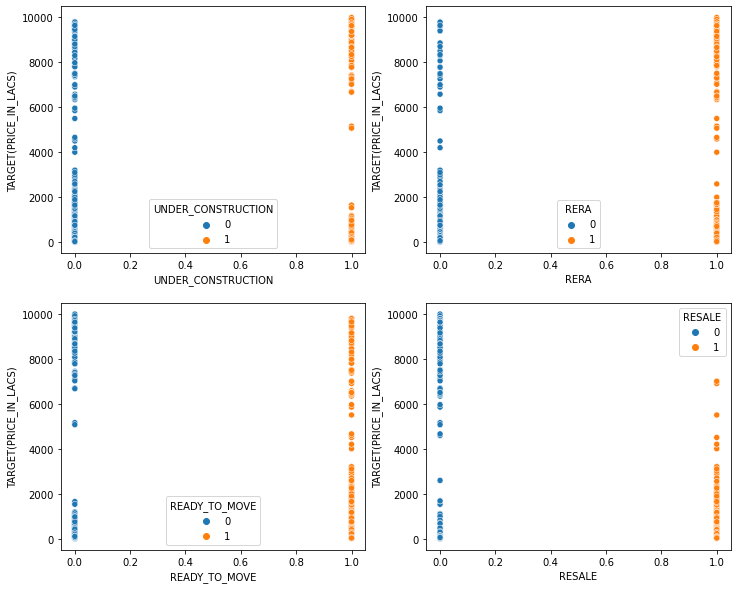

In [86]:
plt.figure(figsize=(12,10))
plt.subplot(2,2,1)
sns.scatterplot('UNDER_CONSTRUCTION','TARGET(PRICE_IN_LACS)', data=df,hue='UNDER_CONSTRUCTION')
plt.subplot(2,2,2)
sns.scatterplot('RERA','TARGET(PRICE_IN_LACS)', data=df,hue='RERA')
plt.subplot(2,2,3)
sns.scatterplot('READY_TO_MOVE','TARGET(PRICE_IN_LACS)', data=df,hue='READY_TO_MOVE')
plt.subplot(2,2,4)
sns.scatterplot('RESALE','TARGET(PRICE_IN_LACS)', data=df,hue='RESALE')


plt.show()

<AxesSubplot:title={'center':'Price vs No of Bedrooms'}, xlabel='BHK_NO.', ylabel='TARGET(PRICE_IN_LACS)'>

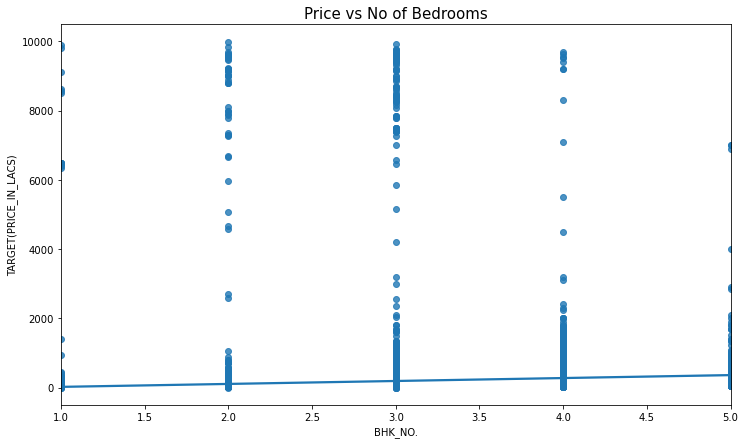

In [87]:

plt.figure(figsize=(12, 7))
plt.title('Price vs No of Bedrooms',size=15)
sns.regplot(x='BHK_NO.', y='TARGET(PRICE_IN_LACS)', data=df)

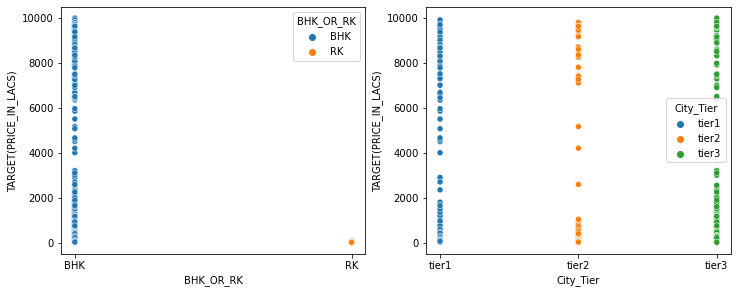

In [28]:
plt.figure(figsize=(12,10))
plt.subplot(2,2,1)
sns.scatterplot('BHK_OR_RK','TARGET(PRICE_IN_LACS)', data=df,hue='BHK_OR_RK')
plt.subplot(2,2,2)
sns.scatterplot('City_Tier','TARGET(PRICE_IN_LACS)', data=df,hue='City_Tier')
plt.show()

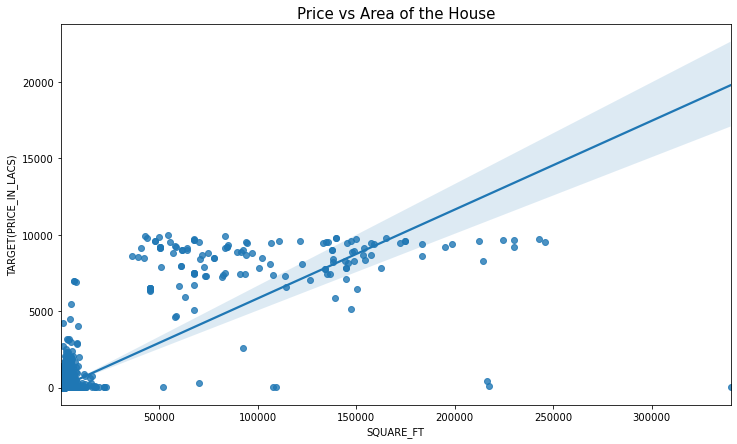

In [89]:
plt.figure(figsize=(12, 7))
plt.title('Price vs Area of the House',size=15)
sns.regplot(x='SQUARE_FT', y='TARGET(PRICE_IN_LACS)', data=df)
plt.show()

In [30]:
tier_median=pd.pivot_table(df, index='City_Tier', aggfunc='median')
tier_median['TARGET(PRICE_IN_LACS)']

City_Tier
tier1    72.3
tier2    47.8
tier3    77.5
Name: TARGET(PRICE_IN_LACS), dtype: float64

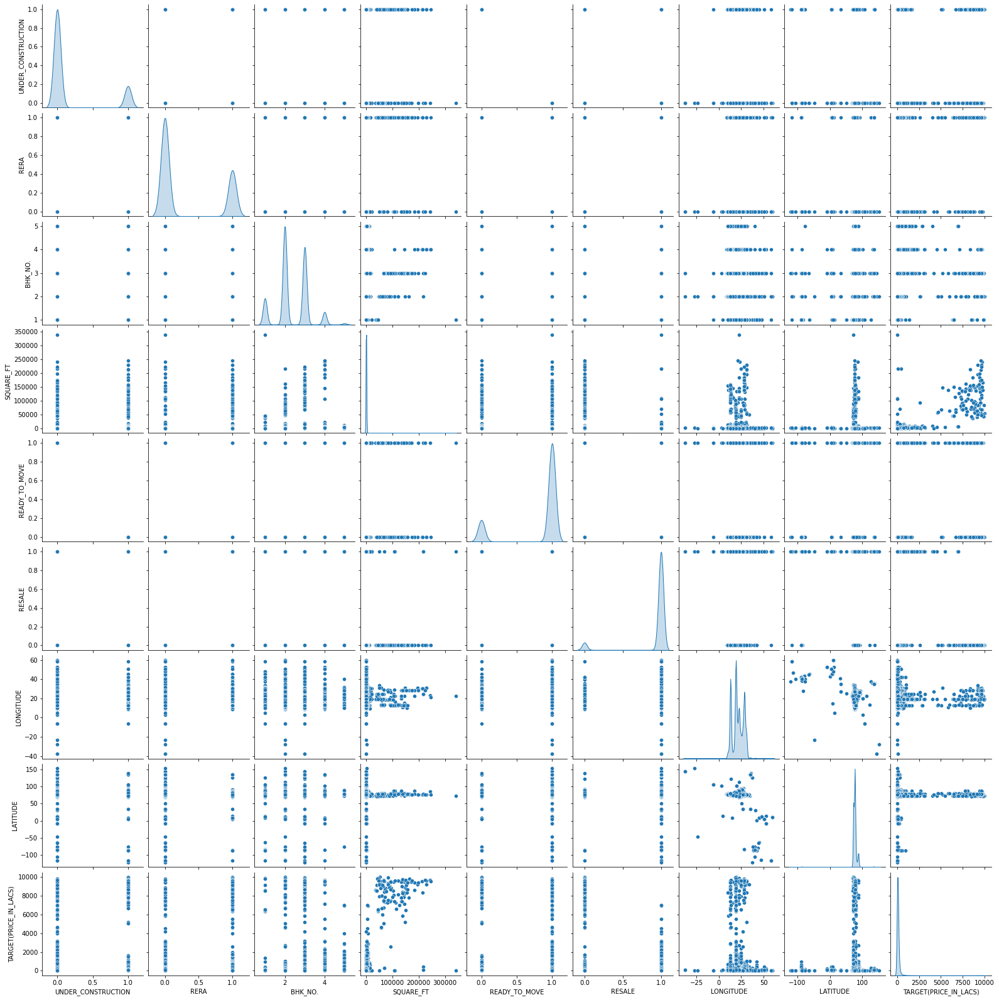

In [92]:
sns.pairplot(df,diag_kind='kde')

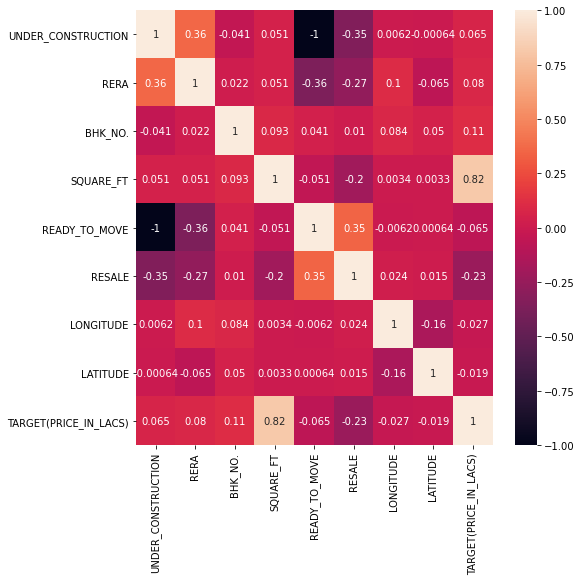

In [90]:
plt.figure(figsize=(8, 8))
sns.heatmap(df.corr(),annot=True)
plt.show()


## Feature Engineering

<AxesSubplot:xlabel='SQUARE_FT', ylabel='Density'>

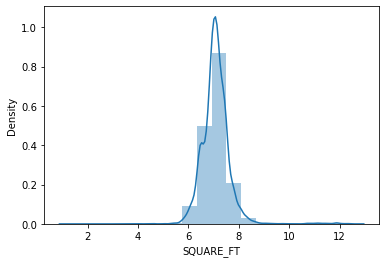

In [32]:
df['SQUARE_FT']=np.log(df['SQUARE_FT'])
sns.distplot(df['SQUARE_FT'],bins=20)

<AxesSubplot:xlabel='TARGET(PRICE_IN_LACS)', ylabel='Density'>

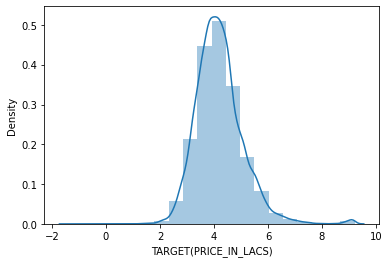

In [33]:
df['TARGET(PRICE_IN_LACS)']=np.log(df['TARGET(PRICE_IN_LACS)'])
sns.distplot(df['TARGET(PRICE_IN_LACS)'],bins=20)

In [34]:
df.columns

Index(['POSTED_BY', 'UNDER_CONSTRUCTION', 'RERA', 'BHK_NO.', 'BHK_OR_RK',
       'SQUARE_FT', 'READY_TO_MOVE', 'RESALE', 'ADDRESS', 'LONGITUDE',
       'LATITUDE', 'TARGET(PRICE_IN_LACS)', 'City_Tier'],
      dtype='object')

In [35]:
ohe_columns=['POSTED_BY', 'UNDER_CONSTRUCTION', 'RERA','BHK_OR_RK','READY_TO_MOVE', 'RESALE']
df= pd.get_dummies(df, columns = ohe_columns,drop_first=True)

In [36]:
df.head()

,BHK_NO.,SQUARE_FT,ADDRESS,LONGITUDE,LATITUDE,TARGET(PRICE_IN_LACS),City_Tier,POSTED_BY_Dealer,POSTED_BY_Owner,UNDER_CONSTRUCTION_1,RERA_1,BHK_OR_RK_RK,READY_TO_MOVE_1,RESALE_1
0,2,7.170301,Bangalore,12.969910,77.597960,4.007333,tier1,0,1,0,0,0,1,1
1,2,7.150701,Mysore,12.274538,76.644605,3.931826,tier2,1,0,0,0,0,1,1
2,2,6.838576,Bangalore,12.778033,77.632191,3.761200,tier1,0,1,0,0,0,1,1
3,2,6.835100,Ghaziabad,28.642300,77.344500,4.135167,tier2,0,1,0,1,0,1,1
4,2,6.906764,Kolkata,22.592200,88.484911,4.102643,tier1,1,0,1,0,0,0,1


In [37]:
address_frq=(df.groupby('ADDRESS').size()) / len(df)
df['ADDRESS'] = df['ADDRESS'].apply(lambda x : address_frq[x])
df.head()

,BHK_NO.,SQUARE_FT,ADDRESS,LONGITUDE,LATITUDE,TARGET(PRICE_IN_LACS),City_Tier,POSTED_BY_Dealer,POSTED_BY_Owner,UNDER_CONSTRUCTION_1,RERA_1,BHK_OR_RK_RK,READY_TO_MOVE_1,RESALE_1
0,2,7.170301,0.147291,12.969910,77.597960,4.007333,tier1,0,1,0,0,0,1,1
1,2,7.150701,0.001465,12.274538,76.644605,3.931826,tier2,1,0,0,0,0,1,1
2,2,6.838576,0.147291,12.778033,77.632191,3.761200,tier1,0,1,0,0,0,1,1
3,2,6.835100,0.037036,28.642300,77.344500,4.135167,tier2,0,1,0,1,0,1,1
4,2,6.906764,0.058058,22.592200,88.484911,4.102643,tier1,1,0,1,0,0,0,1


In [38]:
df['SQUARE_FT']=((df['SQUARE_FT']-df['SQUARE_FT'].mean())/df['SQUARE_FT'].std())
df['BHK_NO.']=((df['BHK_NO.']-df['BHK_NO.'].mean())/df['BHK_NO.'].std())

In [39]:
df.head()

,BHK_NO.,SQUARE_FT,ADDRESS,LONGITUDE,LATITUDE,TARGET(PRICE_IN_LACS),City_Tier,POSTED_BY_Dealer,POSTED_BY_Owner,UNDER_CONSTRUCTION_1,RERA_1,BHK_OR_RK_RK,READY_TO_MOVE_1,RESALE_1
0,-0.469956,0.156898,0.147291,12.969910,77.597960,4.007333,tier1,0,1,0,0,0,1,1
1,-0.469956,0.122567,0.001465,12.274538,76.644605,3.931826,tier2,1,0,0,0,0,1,1
2,-0.469956,-0.424150,0.147291,12.778033,77.632191,3.761200,tier1,0,1,0,0,0,1,1
3,-0.469956,-0.430240,0.037036,28.642300,77.344500,4.135167,tier2,0,1,0,1,0,1,1
4,-0.469956,-0.304713,0.058058,22.592200,88.484911,4.102643,tier1,1,0,1,0,0,0,1


## **MODEL BUILDING**

In [40]:
df.head()

,BHK_NO.,SQUARE_FT,ADDRESS,LONGITUDE,LATITUDE,TARGET(PRICE_IN_LACS),City_Tier,POSTED_BY_Dealer,POSTED_BY_Owner,UNDER_CONSTRUCTION_1,RERA_1,BHK_OR_RK_RK,READY_TO_MOVE_1,RESALE_1
0,-0.469956,0.156898,0.147291,12.969910,77.597960,4.007333,tier1,0,1,0,0,0,1,1
1,-0.469956,0.122567,0.001465,12.274538,76.644605,3.931826,tier2,1,0,0,0,0,1,1
2,-0.469956,-0.424150,0.147291,12.778033,77.632191,3.761200,tier1,0,1,0,0,0,1,1
3,-0.469956,-0.430240,0.037036,28.642300,77.344500,4.135167,tier2,0,1,0,1,0,1,1
4,-0.469956,-0.304713,0.058058,22.592200,88.484911,4.102643,tier1,1,0,1,0,0,0,1


In [41]:
X=df.drop(['LONGITUDE', 'LATITUDE',
       'TARGET(PRICE_IN_LACS)', 'City_Tier','UNDER_CONSTRUCTION_1'],axis=1)
y=df['TARGET(PRICE_IN_LACS)']

In [42]:
X.head()

,BHK_NO.,SQUARE_FT,ADDRESS,POSTED_BY_Dealer,POSTED_BY_Owner,RERA_1,BHK_OR_RK_RK,READY_TO_MOVE_1,RESALE_1
0,-0.469956,0.156898,0.147291,0,1,0,0,1,1
1,-0.469956,0.122567,0.001465,1,0,0,0,1,1
2,-0.469956,-0.424150,0.147291,0,1,0,0,1,1
3,-0.469956,-0.430240,0.037036,0,1,1,0,1,1
4,-0.469956,-0.304713,0.058058,1,0,0,0,0,1


In [45]:
import xgboost as xgb
LR=LinearRegression()
KNN=KNeighborsRegressor()
DT=DecisionTreeRegressor()
RF=RandomForestRegressor()
XGB=xgb.XGBRegressor()
GBoost=GradientBoostingRegressor()

In [46]:
models = []
models.append(('MVLR', LR))
models.append(('KNNRegressor',KNN))
models.append(('DT_Regressor',DT))
models.append(('RF_Regressor',RF))
models.append(('XGBoost',XGB))
models.append(('GradientBoostRegressor',GBoost))


MVLR: 0.580361 (0.011774)
KNNRegressor: 0.500348 (0.012764)
DT_Regressor: 0.512133 (0.014520)
RF_Regressor: 0.404963 (0.007197)
XGBoost: 0.379767 (0.009516)
GradientBoostRegressor: 0.406109 (0.008853)


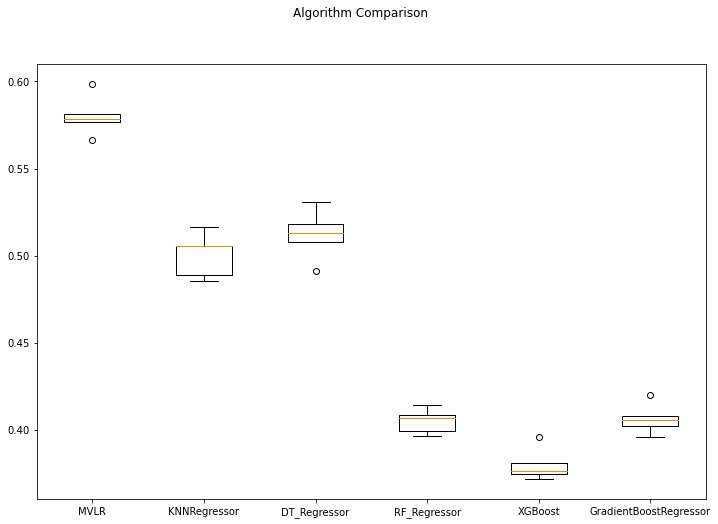

In [47]:
results = []
names = []
for name, model in models:
    kfold = model_selection.KFold(shuffle=True,n_splits=5,random_state=0)
    cv_results = model_selection.cross_val_score(model, X, y,
                                      cv=kfold, scoring='neg_mean_squared_error')
    results.append(np.sqrt(np.abs(cv_results))) #for ploting purpose
    names.append(name)
    print("%s: %f (%f)" % (name, np.mean(np.sqrt(np.abs(cv_results))),
                           np.std(np.sqrt(np.abs(cv_results)),ddof=1)))
   # boxplot algorithm comparison
fig = plt.figure(figsize=(12,8))
fig.suptitle('Algorithm Comparison')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names)
plt.show()

It can be observed that XGboost is perforing the best

## Hypertuning XGBoooost

In [48]:
xgb_params = { 'max_depth': [3,6,10],
           'learning_rate': [0.01, 0.05, 0.1],
           'n_estimators': [100, 500, 1000],
           'colsample_bytree': [0.3, 0.7]}
GS=GridSearchCV(XGB,xgb_params,cv=5,scoring='neg_mean_squared_error')

In [49]:
%%timea
GS.fit(X,y)

Wall time: 16min 44s


GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    enable_categorical=False, gamma=None,
                                    gpu_id=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_delta_step=None,
                                    max_depth=None, min_child_weight=None,
                                    missing=nan, monotone_constraints=None,
                                    n...jobs=None,
                                    num_parallel_tree=None, predictor=None,
                                    random_state=None, reg_alpha=None,
                                    reg_lambda=None, scale_pos_weight=None,
                       

In [50]:
GS.best_params_ 

{'colsample_bytree': 0.7,
 'learning_rate': 0.05,
 'max_depth': 10,
 'n_estimators': 500}

In [51]:
XGB_tuned=xgb.XGBRegressor(colsample_bytree=0.7,
 learning_rate=0.05,
 max_depth= 10,
 n_estimators= 500)
XGB_tuned.fit(X,y)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.7, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.05, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=500, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [52]:
kfold = model_selection.KFold(shuffle=True,n_splits=5,random_state=0)
cv_results = model_selection.cross_val_score(XGB_tuned, X, y,
                                      cv=kfold, scoring='neg_mean_squared_error')

In [53]:
print('RMSE: ',np.mean(np.sqrt(np.abs(cv_results))))
print('Std.Dev: ',np.std(np.sqrt(np.abs(cv_results))))

RMSE:  0.3728438194481541
Std.Dev:  0.008619381846569296


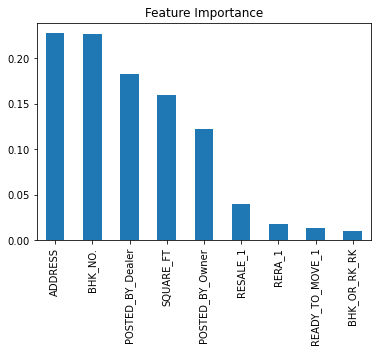

In [56]:
coef = pd.Series(XGB_tuned.feature_importances_, X.columns).sort_values(ascending=False)
coef.plot(kind='bar', title='Feature Importance')
plt.show()

##### We are able to deliver a model with an average error of 37,000 from the actual predicted value with a very negligible standard deviation making it a potential model to predict our target values. Address is seen to be the most important feature followed by the number of bedrooms.


## Checking our model performance using a plot

In [97]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 1, test_size = 0.2)

In [98]:
y_pred=XGB_tuned.predict(X_test)

In [101]:
y_pred[:5]

array([4.42167  , 4.0026097, 4.1766863, 4.111128 , 5.7060127],
      dtype=float32)

In [102]:
y_test[:5]

25749    4.454347
27384    3.968403
21363    4.219508
18832    3.806662
13439    5.347108
Name: TARGET(PRICE_IN_LACS), dtype: float64

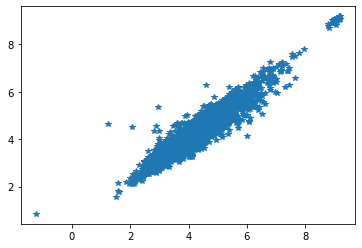

In [106]:
plt.plot(y_test,y_pred,'*')
plt.show()

##### It can be observed that the graph is linear and is doing a good job in predicting the price of the houses.